In [1]:
import sys
import os

current_dir =  os.getcwd()
parent_dir = os.path.dirname(current_dir)
sys.path.insert(0, parent_dir)

import time
import random
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
import pandas as pd
import random
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image 

from collab import foraging_toolkit as ft


import torch
import pyro
import torch.nn.functional as F
import pyro.distributions as dist
import pyro.optim as optim
from pyro.nn import PyroModule
from pyro.infer.autoguide import AutoNormal, AutoDiagonalNormal, AutoMultivariateNormal, init_to_mean, init_to_value
from pyro.contrib.autoguide import AutoLaplaceApproximation
from pyro.infer import SVI, Trace_ELBO
from pyro.optim import Adam
from pyro.infer import Predictive
from pyro.infer import MCMC, NUTS

import logging
logging.basicConfig(format='%(message)s', level=logging.INFO)
smoke_test = ('CI' in os.environ)


## Random birds

### Running a simulation

In [2]:
random.seed(22)
np.random.seed(22)

random_birds_sim = ft.RandomBirds(grid_size= 40,
                        probabilities= [1, 2, 3, 2, 1, 2, 3, 2, 1],
                        num_birds= 3,
                        num_frames= 50,
                        num_rewards= 15,
                        grab_range= 3)

#run a particular simulation with these parameters
random_birds_sim()

# you have created birds and rewards in a space-time grid
# each row contains the x and y coordinates of a bird at a particular time

random_birds_sim.birdsDF.head()

,x,y,time,bird,type
0,18.0,18.0,1,1,random
1,18.0,20.0,2,1,random
2,17.0,21.0,3,1,random
3,20.0,20.0,4,1,random
4,17.0,24.0,5,1,random


In [ ]:
# look at just the birds

ft.animate_birds(random_birds_sim, plot_rewards=True,
                  width = 600, height = 600, point_size = 6)

### Derived predictors

In [3]:
# add derived predictors to the simulation object

random_birds_derived = ft.derive_predictors(random_birds_sim, dropna = False)

2023-09-26 02:00:32,194:  traces done
2023-09-26 02:00:32,710:  visibility done
2023-09-26 02:00:33,268:  proximity done
2023-09-26 02:00:33,453:  how_far done
2023-09-26 02:00:33,530:  derivedDF done
2023-09-26 02:00:33,531:  starting to generate communicates
2023-09-26 02:00:34,449:  communicates done


In [4]:
# now we can plot food traces in time:

ft.animate_birds(random_birds_derived, plot_rewards=True, width = 600,
                  height = 600, point_size = 10,plot_traces=True)

In [ ]:
# we can also plot visibility, for one bird at a time
# as multiple birds' visibility is hard to see 
# let's say, bird 2

ft.animate_birds(random_birds_derived, plot_rewards=True, width = 600,
                  height = 600, point_size = 10, 
                  plot_visibility=2, plot_traces=True)


In [ ]:
# we can plot proximity score
# bird 2 again

ft.animate_birds(random_birds_derived, plot_rewards=True, width = 600,
                  height = 600, point_size = 10, plot_proximity=2, proximity_multiplier=25)

In [ ]:
# this exports and crops frame 3
prox_anim = ft.animate_birds(random_birds_derived, plot_rewards=True, width = 600,
                  height = 600, point_size = 10, plot_proximity=2, proximity_multiplier=25,
                  produce_object=True)

prox_frame3 = go.Figure(prox_anim.frames[0].data, prox_anim.layout)
prox_frame3.update_layout(title_text = "Proximity scores (bird 2)")

pio.write_image(prox_frame3, 'exported_figures/fig1_proximity.png', 
               engine = "kaleido", width=600, height=600, scale=5)

prox_frame3_image = Image.open('exported_figures/fig1_proximity.png')
prox_frame3_cropped = prox_frame3_image.crop((700, 250, 2950, 2000))
prox_frame3_cropped.save('exported_figures/fig1_proximity_cropped.png')


### Inference


In [5]:
# prepare data

def prep_data_for_inference(sim_derived):

    df = sim_derived.derivedDF[["proximity_standardized",
                         "trace_standardized", 
                         "visibility", "how_far_squared_scaled"]]

    df.dropna(inplace=True)
    
    for column in df.columns:
        df[column] = ft.normalize(df[column])

    data = torch.tensor(df.values, dtype=torch.float32)

    proximity, trace, visibility, how_far = data[:, 0], data[:, 1], data[:, 2], data[:, 3]
    
    print(str(len(proximity)) + " data points prepared for inference, dropped " + str(len(sim_derived.derivedDF) - len(proximity)) + " rows with missing values.")
    return proximity, trace, visibility, how_far


In [6]:
proximity, trace, visibility, how_far_score = prep_data_for_inference(random_birds_derived)

45935 data points prepared for inference, dropped 814 rows with missing values.


In [7]:
ft.visualise_bird_predictors(trace, proximity, how_far_score)

In [ ]:

def summary(samples):
    site_stats = {}
    for site_name, values in samples.items():
        marginal_site = pd.DataFrame(values)
        describe = marginal_site.describe(percentiles=[.05, 0.25, 0.5, 0.75, 0.95]).transpose()
        site_stats[site_name] = describe[["mean", "std", "5%", "25%", "50%", "75%", "95%"]]
    return site_stats


In [ ]:
#setting up the MCMC inference

def mcmc_training(model, num_samples, *args):
    nuts_kernel = NUTS(model)
    mcmc = MCMC(nuts_kernel, num_samples=num_samples, warmup_steps=num_samples//4)
    mcmc.run(*args)

    hmc_samples = {k: v.detach().cpu().numpy() for k, v in mcmc.get_samples().items()}

    for site, values in summary(hmc_samples).items():
        if site in ["t","p"]:
            print("Site: {}".format(site))
            print(values, "\n")

    return hmc_samples

/home/rafal/anaconda3/envs/chirho/lib/python3.11/site-packages/torch/cuda/__init__.py:546: UserWarning:

Can't initialize NVML



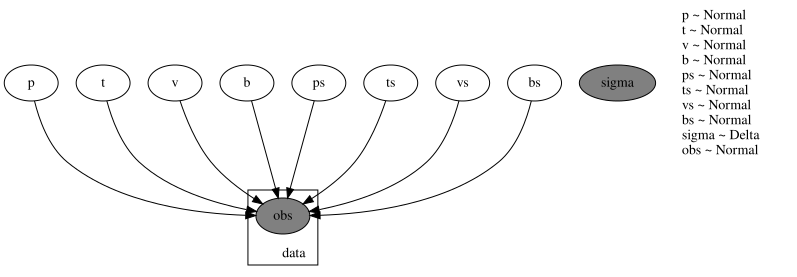

In [8]:
# define the model
# p, t, v, b are the coefficients 
# for proximity, trace, visibility, and the intercept

# ps, ts, vs, bs are analogous coefficients,
# but they contribute to the variance,
# which is not assumed to remain fixed

def model_sigmavar(proximity, trace, visibility, how_far_score):
    p = pyro.sample("p", dist.Normal(0, .3))
    t = pyro.sample("t", dist.Normal(0, .3))
    v = pyro.sample("v", dist.Normal(0, .3))
    b = pyro.sample("b", dist.Normal(.5, .3))

    ps = pyro.sample("ps", dist.Normal(0, .3))
    ts = pyro.sample("ts", dist.Normal(0, .3))
    vs = pyro.sample("vs", dist.Normal(0, .3))
    bs = pyro.sample("bs", dist.Normal(.2, .3))


    sigmaRaw = bs + ps * proximity + ts * trace + vs * visibility
    sigma = pyro.deterministic("sigma", F.softplus(sigmaRaw))
    mean = b + p * proximity + t * trace + v * visibility

    with pyro.plate("data", len(how_far_score)):
        pyro.sample("obs", dist.Normal(mean, sigma), obs=how_far_score)

pyro.render_model(model_sigmavar, model_args=(proximity, trace, visibility, how_far_score),
                        render_distributions=True)

In [9]:
def get_samples( proximity, trace, visibility,
                how_far_score, model = model_sigmavar, num_svi_iters = 1000,
                num_mcmc_samples = 200, num_samples = 1000):
    
    guide = AutoMultivariateNormal(model, init_loc_fn=init_to_mean)
    svi = SVI(model_sigmavar,
        guide,
        optim.Adam({"lr": .01}),
        loss=Trace_ELBO())

    iterations = []
    losses = []
    
    logging.info(f"Starting SVI inference with {num_svi_iters} iterations.")
    start_time = time.time()
    pyro.clear_param_store()
    for i in range(num_svi_iters):
        elbo = svi.step(proximity, trace, visibility, how_far_score)
        iterations.append(i)
        losses.append(elbo)
        if i % 200 == 0:
            logging.info("Elbo loss: {}".format(elbo))
    end_time = time.time()
    elapsed_time = end_time - start_time
    logging.info("SVI inference completed in %.2f seconds.", elapsed_time)

    fig = px.line(x=iterations, y=losses, title="ELBO loss", template="presentation")
    labels={"iterations": "iteration", "losses": "loss"}
    fig.update_xaxes(showgrid=False, title_text=labels["iterations"])
    fig.update_yaxes(showgrid=False, title_text=labels["losses"])
    fig.update_layout(width=700)
    fig.show()
        
    predictive = Predictive(model, guide=guide, 
                        num_samples=num_samples,
                        return_sites = ["t", "p"])
    rhf_svi = {k: v.flatten().reshape(num_samples, -1).detach().cpu().numpy()
            for k, v in predictive(proximity, trace, visibility, how_far_score).items()
            if k != "obs"}
    
    # start_time_mcmc = time.time()
    
    # logging.info(f"Running MCMC inference with {num_mcmc_samples} samples.")
    # nuts_kernel = NUTS(model)
    # mcmc = MCMC(nuts_kernel, num_samples=num_mcmc_samples, warmup_steps=num_samples//4)
    # mcmc.run(proximity, trace, visibility, communicate, how_far_score)
    # communicate_mcmc = {k: v.detach().cpu().numpy() for k, v in mcmc.get_samples().items()}
    # end_time_mcmc = time.time()
    
    # elapsed_time_mcmc = end_time_mcmc - start_time_mcmc
    # logging.info("MCMC inference completed in %.2f seconds.", elapsed_time_mcmc)
    # logging.info("MCMC inference took %.2f times more than SVI inference.", elapsed_time_mcmc/elapsed_time)


    print ("SVI-based coefficient marginals:")
    for site, values in ft.summary(rhf_svi, ["t", "p"]).items():
            print("Site: {}".format(site))
            print(values, "\n")
            
    # print("MCMC-based coefficient marginals:")
    # for site, values in ft.summary(communicate_mcmc, ["t","p", "c"]).items():
    #     print("Site: {}".format(site))
    #     print(values, "\n")            
            
    return {"svi_samples": rhf_svi, "svi_guide": guide, "svi_predictive": predictive}

In [10]:
samples_random = get_samples(proximity, trace, visibility, how_far_score)

2023-09-26 02:01:43,887:  Starting SVI inference with 1000 iterations.
2023-09-26 02:01:43,929:  Elbo loss: 28734.65827047825
2023-09-26 02:01:46,301:  Elbo loss: -19193.543580412865
2023-09-26 02:01:48,597:  Elbo loss: -28791.906107783318
2023-09-26 02:01:50,884:  Elbo loss: -29222.34243285656
2023-09-26 02:01:53,259:  Elbo loss: -29110.578207433224
2023-09-26 02:01:55,568:  SVI inference completed in 11.68 seconds.


SVI-based coefficient marginals:
Site: p
       mean      std        5%       25%       50%       75%       95%
0  0.023632  0.03237 -0.028365  0.001059  0.022661  0.045095  0.077126 

Site: t
       mean       std        5%       25%       50%       75%       95%
0 -0.126784  0.041459 -0.192082 -0.156155 -0.127214 -0.098219 -0.056352 



In [11]:
def plot_coefs(samples, title, ann_start_y = 100, ann_break_y = 50):
    for key in samples['svi_samples'].keys():
        samples['svi_samples'][key] = samples['svi_samples'][key].flatten()

    samplesDF = pd.DataFrame(samples['svi_samples'])
    samplesDF_medians = samplesDF.median(axis = 0 )

    fig_coefs = px.histogram(samplesDF, template = "presentation", 
                opacity = .4,
                labels={"variable": "coefficient"},
                        width  = 700,
                        title  = title,
                        marginal="rug"
                        )

    for i, color in enumerate(['#1f77b4', '#ff7f0e']):
            fig_coefs.add_vline(x=samplesDF_medians[i], line_dash="dash", line_color=color, name=f"Median ({samplesDF_medians[i]})")
        
        
            fig_coefs.add_annotation(
            x=samplesDF_medians[i],
            y= ann_start_y + ann_break_y * i,  # Adjust the vertical position of the label
            text=f"{samplesDF_medians[i]:.2f}",
            showarrow=False,
            bordercolor="black",
            borderwidth=2,
            bgcolor="white",
            opacity=0.8,
            )

    fig_coefs.update_traces(marker=dict(line=dict(width=2, color="Black")))  # Add black outline to bars

    fig_coefs.show()



In [12]:

plot_coefs(samples_random, "Random birds", ann_start_y= 160,  ann_break_y= 10)

In [13]:
# as a sanity check
# compare with the results 
# from the MCMC method

# warning: MCMC training might take a bit of time to run if num_samples is large

random_sigmavar_mcmc = mcmc_training(model_sigmavar, 1000, proximity, trace, visibility, how_far_score)

NameError: name 'mcmc_training' is not defined

In [ ]:
def plot_svi_mcmc_coefficients(svi_sample,mcmc_sample, title, xlim  = .1, ylim = .1):

# TODO change defaults after all plots are checked

    site_p_svi = svi_sample['p'].flatten().tolist()
    site_t_svi = svi_sample['t'].flatten().tolist()
    site_p_mcmc = mcmc_sample['p'].flatten().tolist()
    site_t_mcmc = mcmc_sample['t'].flatten().tolist()

    source_svi = ['svi'] * len(site_p_svi)
    source_mcmc = ['mcmc'] * len(site_p_mcmc)

    data = {
        'p': site_p_svi +  site_p_mcmc,
        't': site_t_svi +  site_t_mcmc,
        'inference_method': source_svi  + source_mcmc
    }

    df = pd.DataFrame(data)

    fig = px.scatter(df, x='p', y='t', color='inference_method', 
                    title= title,
                    template='plotly_dark')

    fig.update_xaxes(range=[-xlim, xlim])
    fig.update_yaxes(range=[-ylim, ylim])

    fig.update_layout(autosize=False,
            width=600,
            height=600
    )

    fig.update_traces(marker=dict(size=3.5, opacity=0.4))

    fig.show()

plot_svi_mcmc_coefficients(random_sigmavar,random_sigmavar_mcmc, 'Random birds (posterior samples)')

In [14]:
def calculate_R_squared(guide):
    predictive = pyro.infer.Predictive(model_sigmavar, guide=guide, num_samples=1000)
    predictions = predictive(proximity, trace, visibility, how_far_score)

    simulated_outcome = ( predictions['b'] + predictions['p'] * proximity +
                      predictions['t'] * trace + predictions['v'] * visibility)

    mean_sim_outcome = simulated_outcome.mean(0).detach().cpu().numpy()

    observed_mean = torch.mean(how_far_score)

    tss = torch.sum((how_far_score - observed_mean) ** 2)
    rss = torch.sum((how_far_score - mean_sim_outcome) ** 2)

    r_squared = 1 - (rss / tss)

    return r_squared.float().item()

In [16]:

print("R squared:", calculate_R_squared(samples_random['svi_guide']))

R squared: 0.41914141178131104


## Hungry birds

In [17]:
# we use a bit more frames,
# a larger grid,
# and more rewards,
# simulation might take a bit longer
hungry_sim = ft.Birds(
    grid_size=60, num_birds=3, num_frames=60, num_rewards=60, grab_range=3
)

hungry_sim()

hungry_sim = ft.add_hungry_birds(
    hungry_sim, num_hungry_birds=3, rewards_decay=0.3, visibility_range=6
)


2023-09-26 02:03:45,946:  Generating frame 10/60 
2023-09-26 02:04:23,711:  Generating frame 20/60 
2023-09-26 02:04:51,550:  Generating frame 30/60 
2023-09-26 02:05:14,079:  Generating frame 40/60 
2023-09-26 02:05:31,651:  Generating frame 50/60 


In [ ]:
ft.animate_birds(
    hungry_sim,
    plot_rewards=True,
    width=600,
    height=600,
    point_size=10,
    plot_traces=False,
)

In [18]:
# adding derived predictors
hungry_sim_derived = ft.derive_predictors(hungry_sim, dropna=False)

# plot with trace
# bird 2 again
ft.animate_birds(
    hungry_sim_derived,
    plot_rewards=True,
    width=600,
    height=600,
    point_size=10,
    plot_traces=True,
    trace_multiplier=7,
)

2023-09-26 02:07:23,288:  traces done
2023-09-26 02:07:24,189:  visibility done
2023-09-26 02:07:24,613:  proximity done
2023-09-26 02:07:24,959:  how_far done
2023-09-26 02:07:25,081:  derivedDF done
2023-09-26 02:07:25,082:  starting to generate communicates
2023-09-26 02:07:26,515:  communicates done


In [ ]:
# now proximity
ft.animate_birds(hungry_sim_derived, plot_rewards=True, width = 600,
                  height = 600, point_size = 10, plot_proximity=1)

In [19]:
proximity, trace, visibility, how_far_score = prep_data_for_inference(hungry_sim_derived)

50520 data points prepared for inference, dropped 873 rows with missing values.


In [ ]:
# notice how higher trace points
# are closer to 1

ft.visualise_bird_predictors(trace, proximity, how_far_score)

In [20]:
samples_hungry = get_samples(proximity, trace, visibility, how_far_score)

2023-09-26 02:07:36,950:  Starting SVI inference with 1000 iterations.
2023-09-26 02:07:36,990:  Elbo loss: 39015.48192465305
2023-09-26 02:07:39,703:  Elbo loss: -21826.476544320583
2023-09-26 02:07:42,138:  Elbo loss: -21243.44356518984
2023-09-26 02:07:44,696:  Elbo loss: -22377.898629665375
2023-09-26 02:07:47,278:  Elbo loss: -22379.44823896885
2023-09-26 02:07:50,015:  SVI inference completed in 13.06 seconds.


SVI-based coefficient marginals:
Site: p
       mean       std        5%       25%       50%       75%       95%
0 -0.045793  0.033634 -0.103719 -0.068559 -0.046479 -0.023533  0.011583 

Site: t
       mean       std        5%       25%       50%       75%       95%
0  1.462698  0.089949  1.315299  1.401213  1.462643  1.518665  1.613427 



In [21]:

plot_coefs(samples_hungry, "Hungry birds", ann_start_y= 160,  ann_break_y= 10)

In [22]:
print("R squared:", calculate_R_squared(samples_hungry['svi_guide']))

R squared: 0.3370743989944458


In [ ]:
# warning: MCMC training might take a bit of time to run if num_samples is large
hungry_sigmavar_mcmc = mcmc_training(model_sigmavar, 1000, proximity, trace, visibility, how_far_score)

In [ ]:
plot_svi_mcmc_coefficients(hungry_sigmavar,hungry_sigmavar_mcmc,
                            'Hungry birds (posterior samples)')

## Follower birds


In [23]:
follower_sim = ft.Birds(
    grid_size=60, num_birds=3, num_frames=60, num_rewards=30, grab_range=3
)
follower_sim()


follower_sim = ft.add_follower_birds(
    follower_sim, num_follower_birds=3, visibility_range=6,
     getting_worse= .5,
    optimal=3,
)

follower_sim_derived = ft.derive_predictors(follower_sim,
                                            getting_worse=.5,
    optimal=3, visibility_range=6, dropna=False)

2023-09-26 02:08:15,141:  Generating frame 10/60 
2023-09-26 02:08:15,650:  Generating frame 20/60 
2023-09-26 02:08:16,260:  Generating frame 30/60 
2023-09-26 02:08:16,891:  Generating frame 40/60 
2023-09-26 02:08:17,483:  Generating frame 50/60 
2023-09-26 02:08:20,981:  traces done
2023-09-26 02:08:21,542:  visibility done
2023-09-26 02:08:22,196:  proximity done
2023-09-26 02:08:22,485:  how_far done
2023-09-26 02:08:22,550:  derivedDF done
2023-09-26 02:08:22,552:  starting to generate communicates
2023-09-26 02:08:23,568:  communicates done


In [ ]:
ft.animate_birds(
    follower_sim_derived,
    plot_rewards=True,
    width=600,
    height=600,
    point_size=10,
    plot_proximity=2,
)

In [24]:
proximity, trace, visibility, how_far_score = prep_data_for_inference(follower_sim_derived)

20001 data points prepared for inference, dropped 339 rows with missing values.


In [ ]:
# now note how points get closer to 1
# as proximity increases
ft.visualise_bird_predictors(trace, proximity, how_far_score)

In [25]:
samples_followers = get_samples(proximity, trace, visibility, how_far_score)

2023-09-26 02:08:36,708:  Starting SVI inference with 1000 iterations.
2023-09-26 02:08:36,743:  Elbo loss: 15691.323416292667
2023-09-26 02:08:39,180:  Elbo loss: -11058.280404150486
2023-09-26 02:08:41,270:  Elbo loss: -11730.661803007126
2023-09-26 02:08:43,470:  Elbo loss: -10407.438751935959
2023-09-26 02:08:45,689:  Elbo loss: -11922.940478086472
2023-09-26 02:08:47,871:  SVI inference completed in 11.16 seconds.


SVI-based coefficient marginals:
Site: p
       mean       std        5%       25%       50%       75%      95%
0  0.194313  0.027868  0.149131  0.175056  0.193859  0.214269  0.24069 

Site: t
       mean       std        5%       25%       50%      75%       95%
0 -0.659967  0.037779 -0.719896 -0.684798 -0.661339 -0.63372 -0.598439 



In [26]:

plot_coefs(samples_followers, "Random birds", ann_start_y= 160,  ann_break_y= 10)

In [27]:
print("R squared:", calculate_R_squared(samples_followers['svi_guide']))

R squared: 0.3291473388671875


In [ ]:
# warning: MCMC training might take a bit of time to run if num_samples is large
follower_sigmavar_mcmc = mcmc_training(model_sigmavar, 300, proximity, trace, visibility, how_far_score)

In [ ]:
plot_svi_mcmc_coefficients(follower_sigmavar,follower_sigmavar_mcmc,
                            'Follower birds (posterior samples)')

In [28]:
def plot_all_coefficients(svi_samples, groups,
                            title, xlim  = .1, ylim = .1):

    data = {
            'p': [],
            't': [],
            'inference_method': [],
            'group': []
        }

    for i, svi_sample in enumerate(svi_samples):
            site_p_svi = svi_sample['p'].flatten().tolist()
            site_t_svi = svi_sample['t'].flatten().tolist()
            data['p'] += site_p_svi
            data['t'] += site_t_svi
            data['inference_method'] += ['svi'] * len(site_p_svi)
            data['group'] += [groups[i]] * len(site_p_svi)

    df = pd.DataFrame(data)

    fig = px.scatter(df, x='p', y='t', color='group', symbol='inference_method',
                     title=title, template='presentation')

    fig.update_xaxes(range=[-xlim, xlim])
    fig.update_yaxes(range=[-ylim, ylim])

    fig.update_layout(
        autosize=False,
        width=600,
        height=600
    )

    fig.update_traces(marker=dict(size=5, opacity=0.7))

    fig.show()



In [ ]:
svi_samples = [samples_random['svi_samples'], samples_hungry['svi_samples'], samples_followers['svi_samples']]

groups = ["random", "hungry", "follower"]

plot_all_coefficients(svi_samples, 
                           groups,
                            "Coefficients for all bird types",
                              xlim  = .07, ylim = .07)


In [ ]:
svi_samples = [random_sigmavar, hungry_sigmavar, follower_sigmavar]
mcmc_samples = [random_sigmavar_mcmc, hungry_sigmavar_mcmc,
                 follower_sigmavar_mcmc]

groups = ["random", "hungry", "follower"]

plot_all_coefficients(svi_samples, 
                          mcmc_samples, groups,
                            "Coefficients for all bird types",
                              xlim  = .07, ylim = .07)
